## Context

## Objective

- Explore and visualize the dataset.
- Build clean the data set and missing values.
- Generate a set of insights from the dataset.

### The key question

Do natural disasters worsen the gender-based nutritional disparity among children in Bangladesh?

### Problem Formulation:

We have a regression problem at hand where we will try to run a diff in diff to see if we can find evidence for a gender bais as.

### Proposed approach

Since it is a regression problem we will first start with the parametric model linear regression with a diff-in-diff approache.

### Overall solution design :

The potential solution design would look like this:

- Checking the data description to get the idea of basic statistics or summary of data.
- Univariate analysis to see how data is spread out, getting to know about the outliers.
- Bivariate analysis to see how different attributes vary with the dependent variable.
- Outlier treatment if needed.
- Missing value treatment using appropriate techniques.
- Feature engineering - transforming features, creating new features if possible.
- Choosing the model evaluation technique - 1) R Squared 2) RMSE can be any other metrics related to regression analysis.
- Splitting the data and proceeding with modeling.


### Measures of success :

R-squared.

## Data Dictionary

## Importing the necessary libraries and overview of the dataset

In [52]:
# Importing the basic libraries we will require for the project

# Import libraries for data manipulation
import pandas as pd
import numpy as np
import os
# Import libraries for data visualization
import matplotlib.pyplot as plt

# Slightly advanced library for data visualization            
import seaborn as sns      

# Import necessary modules
import geopandas as gpd
from geopy.exc import GeocoderTimedOut, GeocoderServiceError

# import module for geoencoding
from geopy.geocoders import Nominatim

# to generate random number
from random import randint

# add sleep time
from time import sleep

import logging

## Functions

In [53]:
# def return_non_na(curr_data,col):
#     return curr_data[col].replace(['HWHAZWHO', 'HWWAZWHO', 'HWWHZWHO','HWBMIZWHO','Missing'], np.NaN, inplace=True)



def reverse_geocode(geolocator, latlon, sleep_sec):
    """
    This function attempts to perform reverse geocoding using the provided geolocator
    and latitude-longitude coordinates. It handles potential errors and retries on timeouts.

    Args:
        geolocator (object): A geocoding library object used for reverse geocoding.
        latlon (str): A string in the format "latitude,longitude" representing the location.
        sleep_sec (int): The maximum number of seconds to sleep between retries on timeouts.

    Returns:
        object: The result of the reverse geocoding request (may vary depending on the geocoder library).
                - On success, returns the geocoded information.
                - On timeout, retries up to sleep_sec seconds and returns the result.
                - On service error or other exceptions, returns None.
    """

    try:
        # Attempt reverse geocoding using the geolocator in English language
        return geolocator.reverse(latlon, language='en')
    except GeocoderTimedOut:
        # Handle timeout error
        logging.info('TIMED OUT: GeocoderTimedOut: Retrying...')
        # Introduce a random sleep between 1 and sleep_sec seconds to avoid overwhelming the service
        sleep(randint(1 * 100, sleep_sec * 100) / 100)
        # Retry the reverse geocoding with the same parameters
        return reverse_geocode(geolocator, latlon, sleep_sec)
    except GeocoderServiceError as e:
        # Handle service error (e.g., connection refused)
        logging.info('CONNECTION REFUSED: GeocoderServiceError encountered.')
        logging.error(e)  # Log the detailed error for debugging
        return None  # Indicate failure
    except Exception as e:
        # Handle unexpected exceptions
        logging.info('ERROR: Terminating due to exception {}'.format(e))
        return None  # Indicate failure
    

def get_local_information(curr_data, sleep_sec):
    """
    This function enriches a DataFrame with local address information based on latitude and longitude data.

    Args:
        curr_data (pandas.DataFrame): A DataFrame with columns 'LATNUM' and 'LONGNUM' containing latitude and longitude values.
        sleep_sec (int): Number of seconds to sleep between retries for error handling.

    Returns:
        pandas.DataFrame: The DataFrame with additional columns for city, village, county, state_district, state, and country.
        """

    # Initialize the Nominatim geocoder with a user agent string (important for API usage guidelines)
    user_agent = 'bibouPaultest_{}'.format(randint(10000, 99999)) + '@gmail.com'
    geolocator = Nominatim(user_agent=user_agent)

    # Iterate through each row of the DataFrame
    for curr_line in range(curr_data.index.max() + 1):

        # Extract latitude and longitude values for the current row
        Latitude = str(curr_data.loc[curr_line, "LATNUM"])
        Longitude = str(curr_data.loc[curr_line, "LONGNUM"])

        # Perform reverse geocoding to get address information
        location = reverse_geocode(geolocator, Latitude + "," + Longitude, sleep_sec)  # Uses a custom function for retries

        # Extract relevant address components from the geocoding result
        if location:
            address = location.raw['address']
            city = address.get('city')
            village = address.get('village')
            county = address.get('county')
            state_district = address.get('state_district')
            state = address.get('state')
            country = address.get('country')

        # Update the DataFrame with the extracted address information
            curr_data.loc[curr_line, 'city'] = city
            curr_data.loc[curr_line, 'village'] = village
            curr_data.loc[curr_line, 'county'] = county
            curr_data.loc[curr_line, 'state_district'] = state_district
            curr_data.loc[curr_line, 'state'] = state
            curr_data.loc[curr_line, 'country'] = country

        else:
            # Update the DataFrame with the extracted address information
            curr_data.loc[curr_line, 'city'] = np.NAN
            curr_data.loc[curr_line, 'village'] = np.NAN
            curr_data.loc[curr_line, 'county'] = np.NAN
            curr_data.loc[curr_line, 'state_district'] = np.NAN
            curr_data.loc[curr_line, 'state'] = np.NAN
            curr_data.loc[curr_line, 'country'] = np.NAN
    
    # Return the DataFrame with the added address information
    return curr_data

## Loading the data

In [54]:
# Importing the datasets

df = pd.read_stata(os.getcwd() + '\\input\\individual_data\\dat\\idhs_00021.dta') 


# Read file using gpd.read_file()
shp_1999 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_1999-00_DHS_03252024_1553_182021\\BDGE42FL\\BDGE42FL.shp')
shp_2004 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_2004_DHS_03252024_1554_182021\\BDGE4JFL\\BDGE4JFL.shp')
shp_2007 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_2007_DHS_03252024_1554_182021\\BDGE52FL\\BDGE52FL.shp')
shp_2011 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_2011_DHS_03252024_1554_182021\\BDGE61FL\\BDGE61FL.shp')
shp_2014 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_2014_DHS_03252024_1554_182021\\BDGE71FL\\BDGE71FL.shp')
shp_2017 = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BD_2017-18_DHS_03252024_1554_182021\\BDGE7SFL\\BDGE7SFL.shp')

# Importing the bangladesh raw map
bgd_adm = gpd.read_file(os.getcwd() + '\\input\\shapefile_data\\shapefile_zip\\BGD_adm\\BGD_adm2.shp')

# Importing crosswalk
crosswalk = pd.read_excel(os.getcwd() + '\\input\\crosswalk_table.xlsx', dtype={
    'Name_shp': 'string',
    'Name_admin': 'string',
    'Source': 'string'
})



# Importing damaged data
housing_dmg = pd.read_excel(os.getcwd() + '\\input\\disaster_data\\housing damages sidr.xlsx', dtype={
    'District': 'string',
    'District corrected': 'string',
    'District Total Population 2007 est.': 'float64',
    'Total Households': 'float64',
    'Total Vulnerable Households': 'float64',
    'Fully Damaged Households': 'float64',
    'Partially Damaged Households': 'float64',
    'Fully Damaged Vulnerable Households': 'float64',
    'Partially Damaged Vulnerable Households': 'float64',
    'Fully Damaged Non vulnerable Households': 'float64',
    'Partially Damaged Non Vulnerable Households': 'float64'
})

In [97]:
# Importing crosswalk
crosswalk = pd.read_excel(os.getcwd() + '\\input\\crosswalk_table.xlsx', dtype={
    'Name_shp': 'string',
    'Name_admin': 'string',
    'Source': 'string'
})

In [55]:
# See variables in the dataset
df.head()

# Convert entire data frame as markdown and print
print(df.to_markdown())

|       | SAMPLE             |   SAMPLESTR | COUNTRY    |   YEAR | IDHSPID             | IDHSHID          | DHSID          |   IDHSPSU |   IDHSSTRATA | CASEID    | HHID   |   PSU |   STRATA |   DOMAIN |   HHNUM |   CLUSTERNO |   LINENO |   BIDX |   PERWEIGHT |   KIDWT |   AWFACTT |   AWFACTU |   AWFACTR |   AWFACTE |   AWFACTW |   DVWEIGHT | URBAN   | GEO_BD1994_2014       | GEO_BD1997   | GEO_BD2000   | GEO_BD2004   | GEO_BD2007   | GEO_BD2011   | GEO_BD2014   |   AGE | AGE5YEAR   | RESIDENT       | RELIGION   | MARSTAT                       |   CHEB | CURRWORK   | WEALTHQ   |   WEALTHS | EDUCLVL      | EDYRTOTAL   | KIDSEX   | LINENOKID               | KIDAGEMO              | HWWEIGHT              | HWHEIGHT              | HWWHYNOTMEAS                      | HWDAYOFBIRTH          | HWHAZWHO                            | HWWAZWHO                            | HWWHZWHO                            | HWBMIZWHO                           |
|------:|:-------------------|------------:|:--------


## Check the data types of the columns for the dataset

In [56]:
# Checking info of the dataset
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42718 entries, 0 to 42717
Data columns (total 56 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   SAMPLE           42718 non-null  category
 1   SAMPLESTR        42718 non-null  category
 2   COUNTRY          42718 non-null  category
 3   YEAR             42718 non-null  int32   
 4   IDHSPID          42718 non-null  object  
 5   IDHSHID          42718 non-null  object  
 6   DHSID            42718 non-null  object  
 7   IDHSPSU          42718 non-null  float64 
 8   IDHSSTRATA       42718 non-null  float64 
 9   CASEID           42718 non-null  object  
 10  HHID             42718 non-null  object  
 11  PSU              42718 non-null  float64 
 12  STRATA           42718 non-null  float64 
 13  DOMAIN           42718 non-null  float64 
 14  HHNUM            42718 non-null  float64 
 15  CLUSTERNO        42718 non-null  float64 
 16  LINENO           42718 non-null  int32  

**Observations**:

Let's check the unique values in each column

In [57]:
# Checking unique values in each column
df.nunique()

SAMPLE                 6
SAMPLESTR              6
COUNTRY                1
YEAR                   6
IDHSPID            34272
IDHSHID            32201
DHSID               2576
IDHSPSU             2576
IDHSSTRATA           717
CASEID             32264
HHID               28398
PSU                  630
STRATA               179
DOMAIN                23
HHNUM                523
CLUSTERNO            630
LINENO                27
BIDX                   5
PERWEIGHT           1657
KIDWT               4019
AWFACTT               60
AWFACTU              102
AWFACTR              192
AWFACTE              142
AWFACTW              123
DVWEIGHT             598
URBAN                  2
GEO_BD1994_2014        5
GEO_BD1997             6
GEO_BD2000             6
GEO_BD2004             6
GEO_BD2007             6
GEO_BD2011             7
GEO_BD2014             7
AGE                   38
AGE5YEAR               9
RESIDENT               2
RELIGION               6
MARSTAT                5
CHEB                  16


In [58]:
df[['HWHAZWHO', 'HWWAZWHO', 'HWWHZWHO','HWBMIZWHO']]

df['HWHAZWHO'].unique()

[-65, 'Missing', -453, -208, 31, ..., 401, 403, 328, 380, 245]
Length: 965
Categories (965, object): [-600 < -599 < -598 < -597 ... 'Age in days out of plausible limits' < 'Flagged cases' < 'Missing' < 'NIU (not in universe)']

In [59]:
df[(df['HWHAZWHO'] == 'Missing') | (df['HWWAZWHO'] == 'Missing') | (df['HWWHZWHO'] == 'Missing')| (df['HWBMIZWHO'] == 'Missing')]
len(df[(df['HWHAZWHO'] == 'Missing') | (df['HWWAZWHO'] == 'Missing') | (df['HWWHZWHO'] == 'Missing')| (df['HWBMIZWHO'] == 'Missing')])

2771

In [60]:

df.KIDSEX.value_counts(normalize=True)
# # return_non_na
# # df.replace('Missing', np.NaN, inplace=True)

# map(return_non_na, df, lst_outcomes)


KIDSEX
Male      0.510487
Female    0.489513
Name: proportion, dtype: float64

In [61]:
for hab in range(5,15):
    print(hab)

5
6
7
8
9
10
11
12
13
14


In [62]:
lst_outcomes=['HWHAZWHO', 'HWWAZWHO', 'HWWHZWHO','HWBMIZWHO']
df[lst_outcomes] = df[lst_outcomes].apply(lambda x: x.replace(['Age in days out of plausible limits','Flagged cases','Missing','NIU (not in universe)'], np.NaN))
df[lst_outcomes] = df[lst_outcomes].apply(lambda x: pd.to_numeric(x, errors='coerce'))


C:\Users\ASUS\AppData\Local\Temp\ipykernel_4384\3933648467.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  df[lst_outcomes] = df[lst_outcomes].apply(lambda x: x.replace(['Age in days out of plausible limits','Flagged cases','Missing','NIU (not in universe)'], np.NaN))


In [63]:
df = df.assign(**{col: df[col] / 100 for col in lst_outcomes})


In [64]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
YEAR,42718.0,2.006058e+03,5.934513e+00,1.997000e+03,2.000000e+03,2.007000e+03,2.011000e+03,2.014000e+03
IDHSPSU,42718.0,5.004658e+09,1.712215e+06,5.002000e+09,5.003000e+09,5.005000e+09,5.006000e+09,5.007001e+09
IDHSSTRATA,42718.0,5.004658e+08,1.711942e+05,5.002000e+08,5.003001e+08,5.005000e+08,5.006000e+08,5.007000e+08
PSU,42718.0,2.778021e+02,1.719360e+02,1.000000e+00,1.280000e+02,2.600000e+02,4.110000e+02,6.300000e+02
STRATA,42718.0,5.859286e+01,5.302699e+01,1.000000e+00,1.600000e+01,3.000000e+01,1.040000e+02,1.790000e+02
DOMAIN,42718.0,9.638911e+00,6.877968e+00,0.000000e+00,4.000000e+00,9.000000e+00,1.600000e+01,2.200000e+01
HHNUM,42718.0,8.521356e+01,8.295318e+01,1.000000e+00,3.100000e+01,6.300000e+01,1.050000e+02,6.380000e+02
CLUSTERNO,42718.0,2.778021e+02,1.719360e+02,1.000000e+00,1.280000e+02,2.600000e+02,4.110000e+02,6.300000e+02
LINENO,42718.0,2.882860e+00,2.040245e+00,1.000000e+00,2.000000e+00,2.000000e+00,3.000000e+00,2.800000e+01
BIDX,42718.0,1.214851e+00,4.529014e-01,1.000000e+00,1.000000e+00,1.000000e+00,1.000000e+00,5.000000e+00


In [65]:
print(df.head().to_markdown())

|    | SAMPLE             |   SAMPLESTR | COUNTRY    |   YEAR | IDHSPID             | IDHSHID          | DHSID          |   IDHSPSU |   IDHSSTRATA | CASEID    | HHID   |   PSU |   STRATA |   DOMAIN |   HHNUM |   CLUSTERNO |   LINENO |   BIDX |   PERWEIGHT |   KIDWT |   AWFACTT |   AWFACTU |   AWFACTR |   AWFACTE |   AWFACTW |   DVWEIGHT | URBAN   | GEO_BD1994_2014   | GEO_BD1997   |   GEO_BD2000 |   GEO_BD2004 |   GEO_BD2007 |   GEO_BD2011 |   GEO_BD2014 |   AGE | AGE5YEAR   | RESIDENT       | RELIGION   | MARSTAT   |   CHEB | CURRWORK   | WEALTHQ   |   WEALTHS | EDUCLVL   |   EDYRTOTAL | KIDSEX   |   LINENOKID |   KIDAGEMO |   HWWEIGHT | HWHEIGHT   | HWWHYNOTMEAS   | HWDAYOFBIRTH   |   HWHAZWHO |   HWWAZWHO |   HWWHZWHO |   HWBMIZWHO |
|---:|:-------------------|------------:|:-----------|-------:|:--------------------|:-----------------|:---------------|----------:|-------------:|:----------|:-------|------:|---------:|---------:|--------:|------------:|---------:|-------:|----------

In [66]:
df['YEAR'] = df['YEAR'].astype("category")

In [67]:

# duplication
df[df.duplicated()]

,SAMPLE,SAMPLESTR,COUNTRY,YEAR,IDHSPID,IDHSHID,DHSID,IDHSPSU,IDHSSTRATA,CASEID,...,LINENOKID,KIDAGEMO,HWWEIGHT,HWHEIGHT,HWWHYNOTMEAS,HWDAYOFBIRTH,HWHAZWHO,HWWAZWHO,HWWHZWHO,HWBMIZWHO


**Observations**:
No duplicate observations.

## Exploratory Data Analysis

Now that we have an understanding of the business problem we want to solve, and we have loaded the datasets, the next step to follow is to have a better understanding of the dataset, i.e., what is the distribution of the variables, what are different relationships that exist between variables, etc. If there are any data anomalies like missing values or outliers, how do we treat them to prepare the dataset for building the model?

Let's check the percentage of missing values using the below code.

In [68]:
# Missing values
pd.DataFrame(data={'% of Missing Values':round(df.isna().sum()/df.isna().count()*100,2),'Nbr of Missing Values':df.isna().sum()}).sort_values(by='% of Missing Values',ascending=False)


,% of Missing Values,Nbr of Missing Values
GEO_BD2007,85.60,36568
DVWEIGHT,85.60,36568
GEO_BD1997,85.51,36529
GEO_BD2000,84.01,35886
GEO_BD2004,83.83,35810
GEO_BD2014,81.54,34832
GEO_BD2011,79.51,33965
AWFACTW,30.48,13021
LINENOKID,30.48,13021
HWWHZWHO,15.95,6812


In [69]:

#outcome variable 
outcomes_cols = ['HWHAZWHO', 'HWWAZWHO', 'HWWHZWHO','HWBMIZWHO']



In [70]:
#Summarize data
df.describe().T

df.columns

Index(['SAMPLE', 'SAMPLESTR', 'COUNTRY', 'YEAR', 'IDHSPID', 'IDHSHID', 'DHSID',
       'IDHSPSU', 'IDHSSTRATA', 'CASEID', 'HHID', 'PSU', 'STRATA', 'DOMAIN',
       'HHNUM', 'CLUSTERNO', 'LINENO', 'BIDX', 'PERWEIGHT', 'KIDWT', 'AWFACTT',
       'AWFACTU', 'AWFACTR', 'AWFACTE', 'AWFACTW', 'DVWEIGHT', 'URBAN',
       'GEO_BD1994_2014', 'GEO_BD1997', 'GEO_BD2000', 'GEO_BD2004',
       'GEO_BD2007', 'GEO_BD2011', 'GEO_BD2014', 'AGE', 'AGE5YEAR', 'RESIDENT',
       'RELIGION', 'MARSTAT', 'CHEB', 'CURRWORK', 'WEALTHQ', 'WEALTHS',
       'EDUCLVL', 'EDYRTOTAL', 'KIDSEX', 'LINENOKID', 'KIDAGEMO', 'HWWEIGHT',
       'HWHEIGHT', 'HWWHYNOTMEAS', 'HWDAYOFBIRTH', 'HWHAZWHO', 'HWWAZWHO',
       'HWWHZWHO', 'HWBMIZWHO'],
      dtype='object')

In [71]:
df.YEAR.value_counts(normalize=True)

YEAR
2011    0.204902
2014    0.184606
2004    0.161712
2000    0.159933
1997    0.144880
2007    0.143967
Name: proportion, dtype: float64

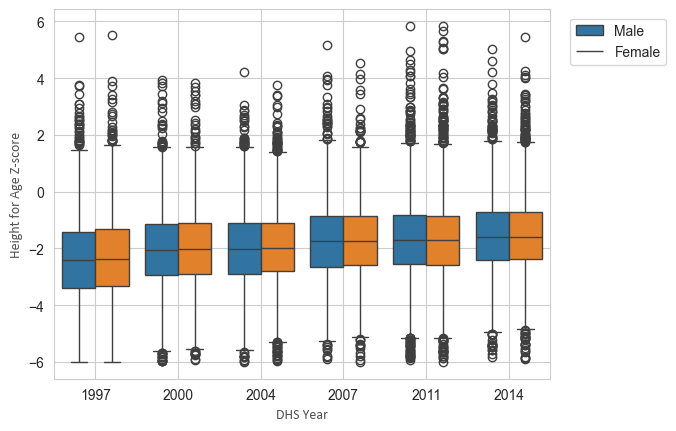

<Figure size 640x480 with 0 Axes>

In [72]:
#  Set labels’ font parameters
sns.set_style("whitegrid")
font_color = '#525252'
csfont = {'fontname':'Georgia'}
hfont = {'fontname':'Calibri'}
facecolor = '#eaeaf2'

g1 = sns.boxplot(data=df, x="YEAR", y="HWHAZWHO", hue="KIDSEX")

g1.set_xlabel("DHS Year", fontsize=10, color=font_color, **hfont)
g1.set_ylabel("Height for Age Z-score", fontsize=10, color=font_color, **hfont)



#title = 'Average Foreign Exchange Rates, 2000–2019'
#fig.suptitle(title, y=.97, fontsize=22, color=font_color, **csfont)
#subtitle = 'Source: Author own calculation'
#plt.title(subtitle, fontsize=18, pad=10, color=font_color, **hfont)
#plt.subplots_adjust(top=0.85)

# title
#new_title = ''
#g1.legend.set_title(new_title)
# replace labels
# new_labels = ['Urban 555', 'Rural']
# for t, l in zip(g1.texts, new_labels):
#     t.set_text(l)
plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Height for Age Z-score dist'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

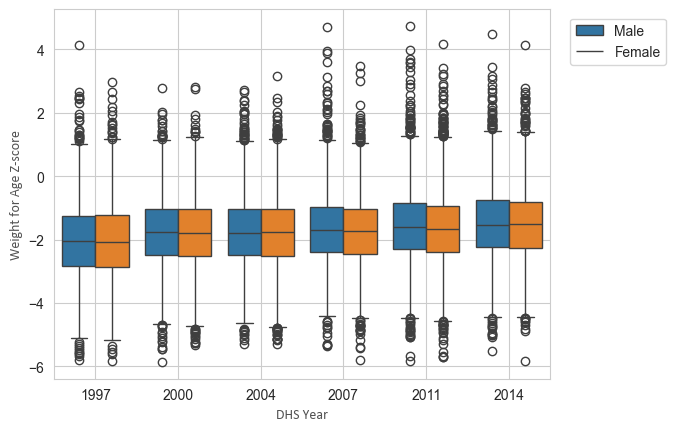

<Figure size 640x480 with 0 Axes>

In [73]:
g2 = sns.boxplot(data=df, x="YEAR", y="HWWAZWHO", hue="KIDSEX")

g2.set_xlabel("DHS Year", fontsize=10, color=font_color, **hfont)
g2.set_ylabel("Weight for Age Z-score", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Weight for Age Z-score dist'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

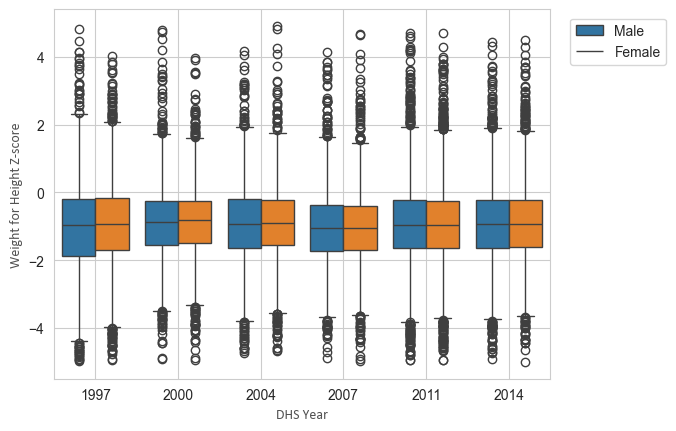

<Figure size 640x480 with 0 Axes>

In [74]:
g3 = sns.boxplot(data=df, x="YEAR", y="HWWHZWHO", hue="KIDSEX")
g3.set_xlabel("DHS Year", fontsize=10, color=font_color, **hfont)
g3.set_ylabel("Weight for Height Z-score", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Weight for Height Z-score dist'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

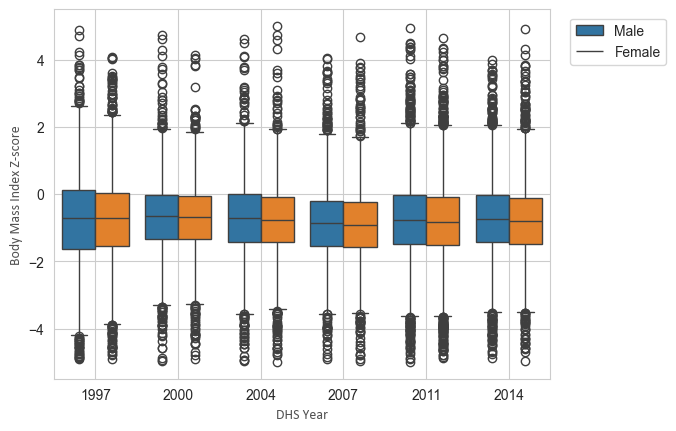

<Figure size 640x480 with 0 Axes>

In [75]:
g4 = sns.boxplot(data=df, x="YEAR", y="HWBMIZWHO", hue="KIDSEX")
g4.set_xlabel("DHS Year", fontsize=10, color=font_color, **hfont)
g4.set_ylabel("Body Mass Index Z-score", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Body Mass Index Z-score dist'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

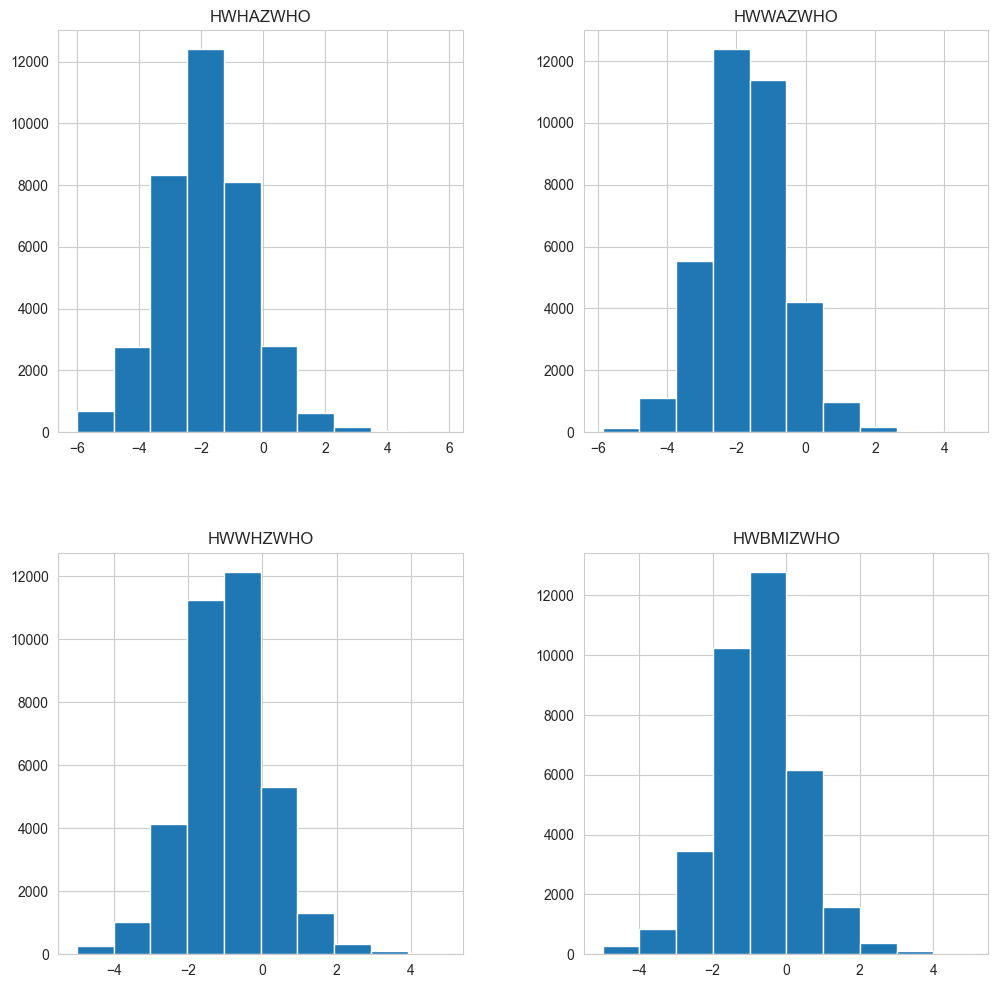

In [76]:
#title=['Height for Age Z-score','Weight for Age Z-score','Weight for Height Z-score','Body Mass Index Z-score']
df[['HWHAZWHO', 'HWWAZWHO', 'HWWHZWHO','HWBMIZWHO']].hist(figsize=(12,12))

#plt.title(title, fontsize=18, pad=10, color=font_color, **hfont)
plt.show()

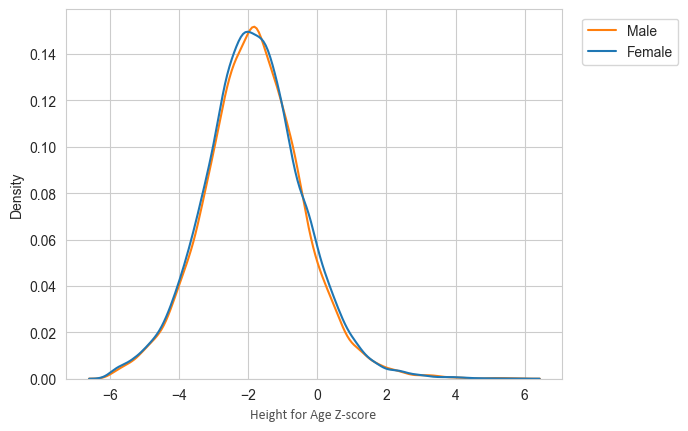

<Figure size 640x480 with 0 Axes>

In [77]:
g5 = sns.kdeplot(data=df, x="HWHAZWHO", hue="KIDSEX")
g5.set_xlabel("Height for Age Z-score ", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Body Mass Index Z-score dist'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

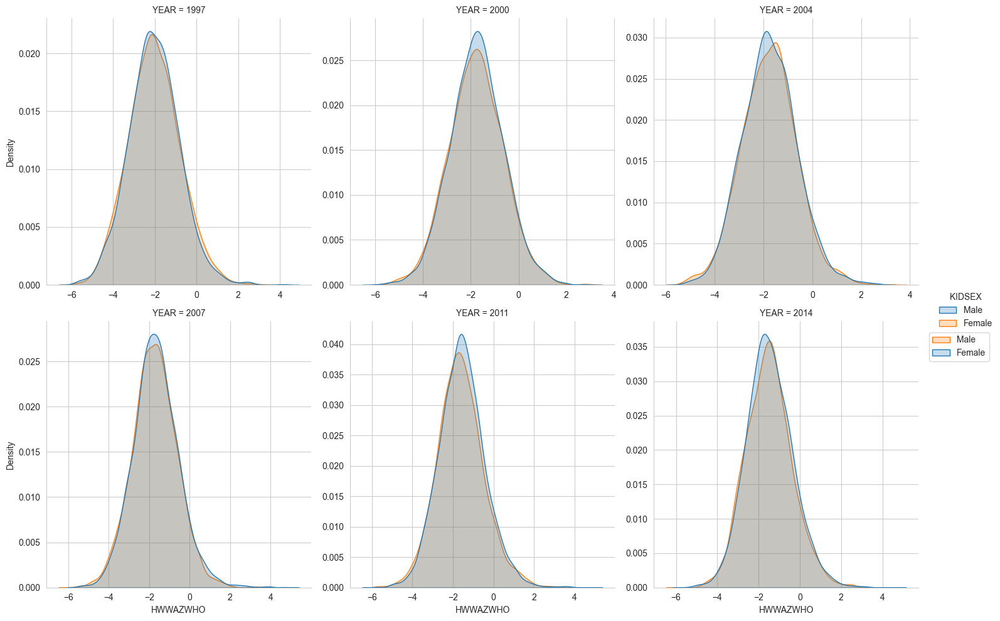

In [78]:
#g10 = sns.FacetGrid(data=df, col='YEAR', hue='KIDSEX', col_wrap=3)

#g10.map(sns.kdeplot, x="HWWAZWHO", cut=0, fill=True,  alpha=1,  clip=(-5, 5))
# g5.set_xlabel("Weight for Age Z-score", fontsize=10, color=font_color, **hfont)


# plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
# plt.grid(True)
# plt.show()

g5 = sns.displot(data=df, col='YEAR', hue='KIDSEX', x='HWWAZWHO', kind='kde', col_wrap=3,fill=True, facet_kws={'sharey': False, 'sharex': False})
# control the title of each facet
#g5 = g5.set_titles("{col_name}")
#g5.set_xlabel("Weight for Age Z-score", fontsize=10, color=font_color, **hfont)
plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
filename = 'Weight for Age Z-score density'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

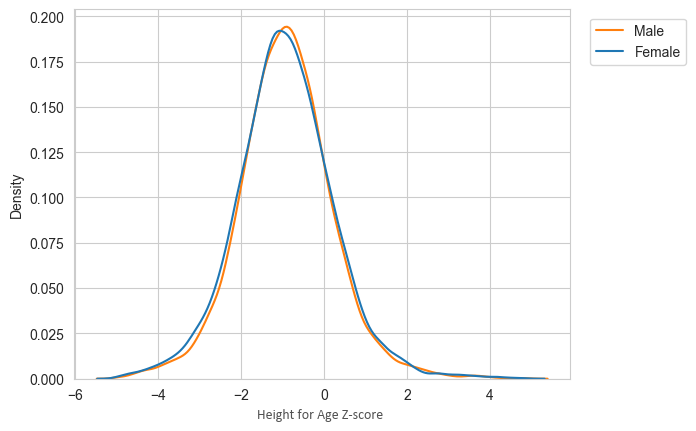

<Figure size 640x480 with 0 Axes>

In [79]:
g5 = sns.kdeplot(data=df, x='HWWHZWHO', hue="KIDSEX")
g5.set_xlabel("Height for Age Z-score ", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Weight for Height Z-score density'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

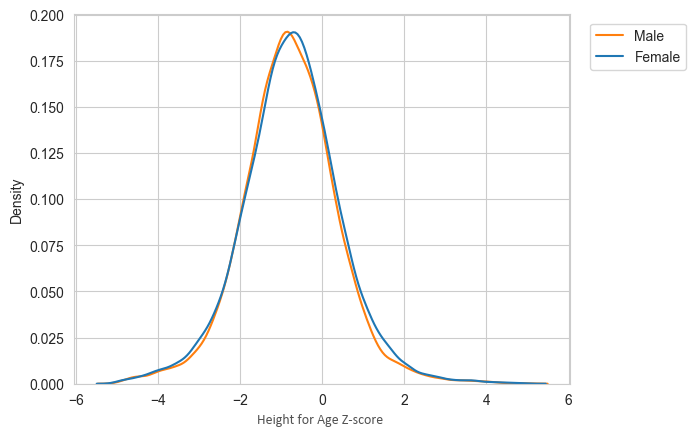

<Figure size 640x480 with 0 Axes>

In [80]:
g5 = sns.kdeplot(data=df, x='HWBMIZWHO', hue="KIDSEX")
g5.set_xlabel("Height for Age Z-score ", fontsize=10, color=font_color, **hfont)


plt.legend(labels= ['Male', 'Female'], loc = (1.04,0.85))
plt.grid(True)
plt.show()

filename = 'Body Mass Index Z-score density'
plt.savefig( os.getcwd() + '\\output\\img\\' + filename+'.jpeg', facecolor=facecolor)

## Spatial data analysis

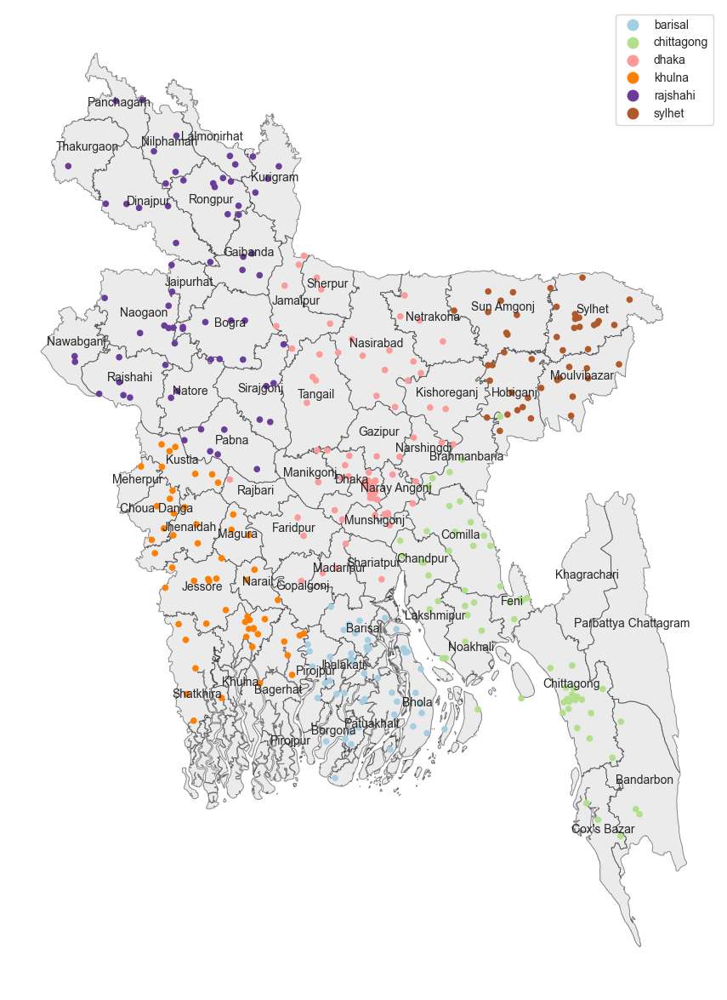

In [106]:
# Représentation graphique des regions du Rwanda 1991

## fig et ax représentent la base de la carte
fig, ax = plt.subplots(figsize=(15,15))
bgd_adm.apply(lambda x: ax.annotate(text=x['NAME_2'], xy=x.geometry.centroid.coords[0], ha='center'), axis=1)
bgd_plot=bgd_adm.plot(ax=ax, color='lightgrey', edgecolor='black',lw=0.7, alpha=0.45)

# Sans axe 
ax.axis('off')

# using set_facecolor() method
ax.set_facecolor("red")

# Rajouter le titre
ax.set_title('', fontsize=23)

# Rajouter les coordonnées GPS des points sur la carte
csm = shp_2007.plot(ax=bgd_plot, column='DHSREGNA', cmap='Paired', markersize=20, legend=True)

In [83]:
shp_2004 = shp_2004.drop(shp_2004[(shp_2004['LATNUM']==0) & (shp_2004['LONGNUM']==0)].index, axis=0)
shp_2014 = shp_2014.drop(shp_2014[(shp_2014['LATNUM']==0) & (shp_2014['LONGNUM']==0)].index, axis=0)

# resetting the DataFrame index
shp_2004 = shp_2004.reset_index()
shp_2014 = shp_2014.reset_index()

In [84]:
# Explicitly specifying the columns for joining
merged = pd.merge(bgd_adm, housing_dmg, left_on='NAME_2', right_on='District corrected', how='outer')



In [85]:
pd.DataFrame(data={'% of Missing Values':round(merged.isna().sum()/merged.isna().count()*100,2),'Nbr of Missing Values':merged.isna().sum()}).sort_values(by='% of Missing Values',ascending=False)


,% of Missing Values,Nbr of Missing Values
NL_NAME_2,100.00,65
VARNAME_2,53.85,35
Partially Damaged Non‐ Vulnerable Households,52.31,34
District corrected,52.31,34
Fully Damaged Non‐ vulnerable Households,52.31,34
Partially Damaged Vulnerable Households,52.31,34
Fully Damaged Vulnerable Households,52.31,34
Partially Damaged Households,52.31,34
Fully Damaged Households,52.31,34
Total Vulnerable Households,52.31,34


In [86]:
merged[['District Total Population 2007 est.','Total Households', 'Total Vulnerable Households','Fully Damaged Households', 'Partially Damaged Households','Fully Damaged Vulnerable Households','Partially Damaged Vulnerable Households','Fully Damaged Non‐ vulnerable Households','Partially Damaged Non‐ Vulnerable Households']] = merged[['District Total Population 2007 est.','Total Households', 'Total Vulnerable Households','Fully Damaged Households', 'Partially Damaged Households','Fully Damaged Vulnerable Households','Partially Damaged Vulnerable Households','Fully Damaged Non‐ vulnerable Households','Partially Damaged Non‐ Vulnerable Households']].replace(np.NaN, '0')


In [87]:
merged.head()

,ID_0,ISO,NAME_0,ID_1,NAME_1,ID_2,NAME_2,TYPE_2,ENGTYPE_2,NL_NAME_2,...,District corrected,District Total Population 2007 est.,Total Households,Total Vulnerable Households,Fully Damaged Households,Partially Damaged Households,Fully Damaged Vulnerable Households,Partially Damaged Vulnerable Households,Fully Damaged Non‐ vulnerable Households,Partially Damaged Non‐ Vulnerable Households
0,20,BGD,Bangladesh,4,Khulna,35,Bagerhat,Zila,District,None,...,Bagerhat,1796876.0,321640.0,16082.0,118899.0,130675.0,5945.0,6534.0,112954.0,124141.0
1,20,BGD,Bangladesh,2,Chittagong,7,Bandarbon,Zila,District,None,...,<NA>,0,0,0,0,0,0,0,0,0
2,20,BGD,Bangladesh,1,Barisal,1,Barisal,Zila,District,None,...,Barisal,2732922.0,475680.0,23784.0,41470.0,92242.0,2074.0,4612.0,39397.0,87630.0
3,20,BGD,Bangladesh,1,Barisal,2,Bhola,Zila,District,None,...,Bhola,1975616.0,328540.0,16427.0,15389.0,20300.0,769.0,1015.0,14620.0,19285.0
4,20,BGD,Bangladesh,5,Rajshahi,46,Bogra,Zila,District,None,...,<NA>,0,0,0,0,0,0,0,0,0


## Get the city, state, and country names from latitude and longitude using Python

In [88]:
shp_1999["city"]=""
shp_1999["village"]=""
shp_1999["county"]=""
shp_1999["state_district"]=""
shp_1999["state"]=""
shp_1999["country"]=""

shp_2004["city"]=""
shp_2004["village"]=""
shp_2004["county"]=""
shp_2004["state_district"]=""
shp_2004["state"]=""
shp_2004["country"]=""

shp_2007["city"]=""
shp_2007["village"]=""
shp_2007["county"]=""
shp_2007["state_district"]=""
shp_2007["state"]=""
shp_2007["country"]=""

shp_2011["city"]=""
shp_2011["village"]=""
shp_2011["county"]=""
shp_2011["state_district"]=""
shp_2011["state"]=""
shp_2011["country"]=""

shp_2014["city"]=""
shp_2014["village"]=""
shp_2014["county"]=""
shp_2014["state_district"]=""
shp_2014["state"]=""
shp_2014["country"]=""

shp_2017["city"]=""
shp_2017["village"]=""
shp_2017["county"]=""
shp_2017["state_district"]=""
shp_2017["state"]=""
shp_2017["country"]=""


# Create the address columns in a single operation for efficiency
# shp_1999['city', 'village', 'county', 'state_district', 'state', 'country']=['','','','','','']
# shp_2004['city', 'village', 'county', 'state_district', 'state', 'country']=["","","","","",""]
# shp_2007['city', 'village', 'county', 'state_district', 'state', 'country']=["","","","","",""]
# shp_2011['city', 'village', 'county', 'state_district', 'state', 'country']=["","","","","",""]
# shp_2014['city', 'village', 'county', 'state_district', 'state', 'country']=["","","","","",""]
# shp_2017['city', 'village', 'county', 'state_district', 'state', 'country']=["","","","","",""]

In [89]:
# Get district related to each cluster
get_local_information(shp_1999, 10)
get_local_information(shp_2004, 10)
get_local_information(shp_2007, 10)
get_local_information(shp_2011, 10)
get_local_information(shp_2014, 10)
get_local_information(shp_2017, 10)

,DHSID,DHSCC,DHSYEAR,DHSCLUST,CCFIPS,ADM1FIPS,ADM1FIPSNA,ADM1SALBNA,ADM1SALBCO,ADM1DHS,...,ALT_GPS,ALT_DEM,DATUM,geometry,city,village,county,state_district,state,country
0,BD201800000001,BD,2018.0,1.0,BG,NULL,NULL,NULL,NULL,1.0,...,49.0,7.0,WGS84,POINT (90.10647 21.90745),None,None,Taltali Subdistrict,Barguna District,Barishal Division,Bangladesh
1,BD201800000002,BD,2018.0,2.0,BG,NULL,NULL,NULL,NULL,1.0,...,34.0,10.0,WGS84,POINT (90.29871 22.17195),None,Haldia,Amtali Subdistrict,Barguna District,Barishal Division,Bangladesh
2,BD201800000003,BD,2018.0,3.0,BG,NULL,NULL,NULL,NULL,1.0,...,22.0,6.0,WGS84,POINT (90.18748 22.16715),Barguna,None,Barguna Sadar Subdistrict,Barguna District,Barishal Division,Bangladesh
3,BD201800000004,BD,2018.0,4.0,BG,NULL,NULL,NULL,NULL,1.0,...,4.0,10.0,WGS84,POINT (90.12207 22.19562),None,Khajurtala,Barguna Sadar Subdistrict,Barguna District,Barishal Division,Bangladesh
4,BD201800000005,BD,2018.0,5.0,BG,NULL,NULL,NULL,NULL,1.0,...,54.0,9.0,WGS84,POINT (90.17927 22.34890),None,None,Betagi Subdistrict,Barguna District,Barishal Division,Bangladesh
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
667,BD201800000671,BD,2018.0,671.0,BG,NULL,NULL,NULL,NULL,8.0,...,42.0,22.0,WGS84,POINT (91.87764 24.88692),Sylhet,None,Sylhet Sadar Upazila,Sylhet District,Sylhet Division,Bangladesh
668,BD201800000672,BD,2018.0,672.0,BG,NULL,NULL,NULL,NULL,8.0,...,76.0,24.0,WGS84,POINT (91.87443 24.90129),Sylhet,None,Sylhet Sadar Upazila,Sylhet District,Sylhet Division,Bangladesh
669,BD201800000673,BD,2018.0,673.0,BG,NULL,NULL,NULL,NULL,8.0,...,137.0,23.0,WGS84,POINT (91.89477 24.89654),Sylhet,None,Sylhet Sadar Upazila,Sylhet District,Sylhet Division,Bangladesh
670,BD201800000674,BD,2018.0,674.0,BG,NULL,NULL,NULL,NULL,8.0,...,20.0,20.0,WGS84,POINT (91.89478 24.89389),Sylhet,None,Sylhet Sadar Upazila,Sylhet District,Sylhet Division,Bangladesh


In [ ]:
# for i in range(len(shp_2004)):
#     print(i)

shp_2004.head()

In [ ]:
#print(shp_2017.state_district.value_counts(normalize=True).to_markdown())

temp1 = [str(element).replace(' District','').replace(' Hill','') for element in shp_2007.state_district.unique()]
temp2 = bgd_adm.NAME_2.unique()

list(set(temp1) - set(temp2))

In [90]:

# shp_1999['state_district'] = shp_1999['state_district'].replace(' District','').replace(' Hill','') 
# shp_2004['state_district'] = shp_2004['state_district'].replace(' District','').replace(' Hill','') 
# shp_2007['state_district'] = shp_2007['state_district'].replace(' District','').replace(' Hill','') 
# shp_2011['state_district'] = shp_2011['state_district'].replace(' District','').replace(' Hill','') 
# shp_2014['state_district'] = shp_2014['state_district'].replace(' District','').replace(' Hill','') 
# shp_2017['state_district'] = shp_2017['state_district'].replace(' District','').replace(' Hill','') 


# Clean 'state_district' column for various DataFrames

# DataFrame loop (assuming shp_1999, shp_2004, etc. are your DataFrames)
for df in [shp_1999, shp_2004, shp_2007, shp_2011, shp_2014, shp_2017]:
    # Replace " District" and " Hill" substrings in the 'state_district' column (case-sensitive)
    df['state_district'] = df['state_district'].str.replace(' District', '', regex=False).str.replace(' Hill', '', regex=False)

# Now all your DataFrames have the 'state_district' column cleaned

In [ ]:
# shp_2017.replace('Satkhira','Shatkhira', inplace=True)
# shp_2017.replace('Habiganj','Shatkhira', inplace=True)
# shp_2017.replace('Joypurhat','Shatkhira', inplace=True)
# shp_2017.replace('Manikganj','Shatkhira', inplace=True)
# shp_2017.replace('Cumilla','Shatkhira', inplace=True)
# shp_2017.replace('Narsingdi','Shatkhira', inplace=True)


# shp_2017.replace('Rangpur','Shatkhira', inplace=True)
# shp_2017.replace('Kushtia','Shatkhira', inplace=True)
# shp_2017.replace('Munshiganj','Shatkhira', inplace=True)
# shp_2017.replace('Chapai Nawabganj','Shatkhira', inplace=True)
# shp_2017.replace('Narayanganj','Shatkhira', inplace=True)
# shp_2017.replace('Sirajganj','Shatkhira', inplace=True)


# shp_2017.replace('লালমনিরহাট জেলা','Shatkhira', inplace=True)
# shp_2017.replace('Chuadanga','Shatkhira', inplace=True)
# shp_2017.replace('Barguna','Shatkhira', inplace=True)
# shp_2017.replace('Chattogram','Shatkhira', inplace=True)
# shp_2017.replace('Bogura','Shatkhira', inplace=True)
# shp_2017.replace('Jashore','Shatkhira', inplace=True)
temp1 = [str(element).replace(' District','').replace(' Hill','') for element in shp_2017.state_district.unique()]
temp2 = bgd_adm.NAME_2.unique()

list(set(temp1) - set(temp2))

In [113]:
# merging with the crosswal

shp_1999.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")
shp_2004.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")
shp_2007.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")
shp_2011.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")
shp_2014.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")
shp_2017.merge(crosswalk, left_on="state_district", right_on="Name_shp", how="outer")

,DHSID,DHSCC,DHSYEAR,DHSCLUST,CCFIPS,ADM1FIPS,ADM1FIPSNA,ADM1SALBNA,ADM1SALBCO,ADM1DHS,...,geometry,city,village,county,state_district,state,country,Name_shp,Name_admin,Source
0,BD201800000268,BD,2018.0,268.0,BG,NULL,NULL,NULL,NULL,4.0,...,POINT (89.77462 22.63654),Bagerhat,None,Bagerhat Sadar Upazila,Bagerhat,Khulna Division,Bangladesh,Bagerhat,Bagerhat,<NA>
1,BD201800000269,BD,2018.0,269.0,BG,NULL,NULL,NULL,NULL,4.0,...,POINT (89.65545 22.66901),None,None,Rampal Upazila,Bagerhat,Khulna Division,Bangladesh,Bagerhat,Bagerhat,<NA>
2,BD201800000270,BD,2018.0,270.0,BG,NULL,NULL,NULL,NULL,4.0,...,POINT (89.72196 22.86751),None,None,None,Bagerhat,Khulna Division,Bangladesh,Bagerhat,Bagerhat,<NA>
3,BD201800000271,BD,2018.0,271.0,BG,NULL,NULL,NULL,NULL,4.0,...,POINT (89.86930 22.43559),None,None,Morrelganj Upazila,Bagerhat,Khulna Division,Bangladesh,Bagerhat,Bagerhat,<NA>
4,BD201800000272,BD,2018.0,272.0,BG,NULL,NULL,NULL,NULL,4.0,...,POINT (89.84422 22.58201),None,Badhal,Kachua Upazila (Bagerhat),Bagerhat,Khulna Division,Bangladesh,Bagerhat,Bagerhat,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
674,BD201800000474,BD,2018.0,474.0,BG,NULL,NULL,NULL,NULL,6.0,...,POINT (89.52049 24.15938),None,None,Faridpur Upazila,None,Rajshahi Division,Bangladesh,<NA>,<NA>,<NA>
675,BD201800000475,BD,2018.0,475.0,BG,NULL,NULL,NULL,NULL,6.0,...,POINT (89.40707 23.90540),None,None,Sujanagar Upazila,None,Rajshahi Division,Bangladesh,<NA>,<NA>,<NA>
676,BD201800000505,BD,2018.0,505.0,BG,NULL,NULL,NULL,NULL,6.0,...,POINT (89.45068 24.17426),None,Bri Lahirbari,Faridpur Upazila,None,Rajshahi Division,Bangladesh,<NA>,<NA>,<NA>
677,BD201800000506,BD,2018.0,506.0,BG,NULL,NULL,NULL,NULL,6.0,...,POINT (89.26007 24.00875),Pabna,None,Pabna Sadar Upazila,None,Rajshahi Division,Bangladesh,<NA>,<NA>,<NA>


In [115]:
shp_2017[shp_2017["state_district"].isna()]
#print(shp_1999.loc[146,:])

,DHSID,DHSCC,DHSYEAR,DHSCLUST,CCFIPS,ADM1FIPS,ADM1FIPSNA,ADM1SALBNA,ADM1SALBCO,ADM1DHS,...,ALT_GPS,ALT_DEM,DATUM,geometry,city,village,county,state_district,state,country
6,BD201800000007,BD,2018.0,7.0,BG,NULL,NULL,NULL,NULL,1.0,...,50.0,7.0,WGS84,POINT (90.18330 22.94123),Barisal District,None,None,None,Barishal Division,Bangladesh
7,BD201800000008,BD,2018.0,8.0,BG,NULL,NULL,NULL,NULL,1.0,...,6.0,9.0,WGS84,POINT (90.32785 22.86964),Barisal District,None,None,None,Barishal Division,Bangladesh
8,BD201800000009,BD,2018.0,9.0,BG,NULL,NULL,NULL,NULL,1.0,...,49.0,4.0,WGS84,POINT (90.45998 22.58575),Barisal District,None,None,None,Barishal Division,Bangladesh
9,BD201800000010,BD,2018.0,10.0,BG,NULL,NULL,NULL,NULL,1.0,...,1.0,2.0,WGS84,POINT (90.22507 22.48151),Barisal District,None,None,None,Barishal Division,Bangladesh
12,BD201800000013,BD,2018.0,13.0,BG,NULL,NULL,NULL,NULL,1.0,...,-14.0,12.0,WGS84,POINT (90.46295 22.95821),Barisal District,None,None,None,Barishal Division,Bangladesh
13,BD201800000014,BD,2018.0,14.0,BG,NULL,NULL,NULL,NULL,1.0,...,41.0,11.0,WGS84,POINT (90.43908 22.72245),Barisal District,None,None,None,Barishal Division,Bangladesh
14,BD201800000015,BD,2018.0,15.0,BG,NULL,NULL,NULL,NULL,1.0,...,13.0,4.0,WGS84,POINT (90.51010 22.77351),Barisal District,None,None,None,Barishal Division,Bangladesh
15,BD201800000016,BD,2018.0,16.0,BG,NULL,NULL,NULL,NULL,1.0,...,38.0,8.0,WGS84,POINT (90.50139 22.83095),Barisal District,None,None,None,Barishal Division,Bangladesh
16,BD201800000017,BD,2018.0,17.0,BG,NULL,NULL,NULL,NULL,1.0,...,98.0,9.0,WGS84,POINT (90.36431 22.92228),Barisal District,None,None,None,Barishal Division,Bangladesh
17,BD201800000018,BD,2018.0,18.0,BG,NULL,NULL,NULL,NULL,1.0,...,46.0,11.0,WGS84,POINT (90.26374 22.78092),Barisal District,None,None,None,Barishal Division,Bangladesh


In [109]:
# Replace nan in state_district to the value in state
shp_1999.state_district = shp_1999.state_district.fillna(shp_1999.state)
shp_2004.state_district = shp_2004.state_district.fillna(shp_2004.state)
shp_2007.state_district = shp_2007.state_district.fillna(shp_2007.state)
shp_2011.state_district = shp_2011.state_district.fillna(shp_2011.state)
shp_2014.state_district = shp_2014.state_district.fillna(shp_2014.state)
shp_2017.state_district = shp_2017.state_district.fillna(shp_2017.state)